<a href="https://colab.research.google.com/github/plaban1981/Hugging_Face_transformers_topics/blob/main/Natural_Language_Processing_using_Transformers.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

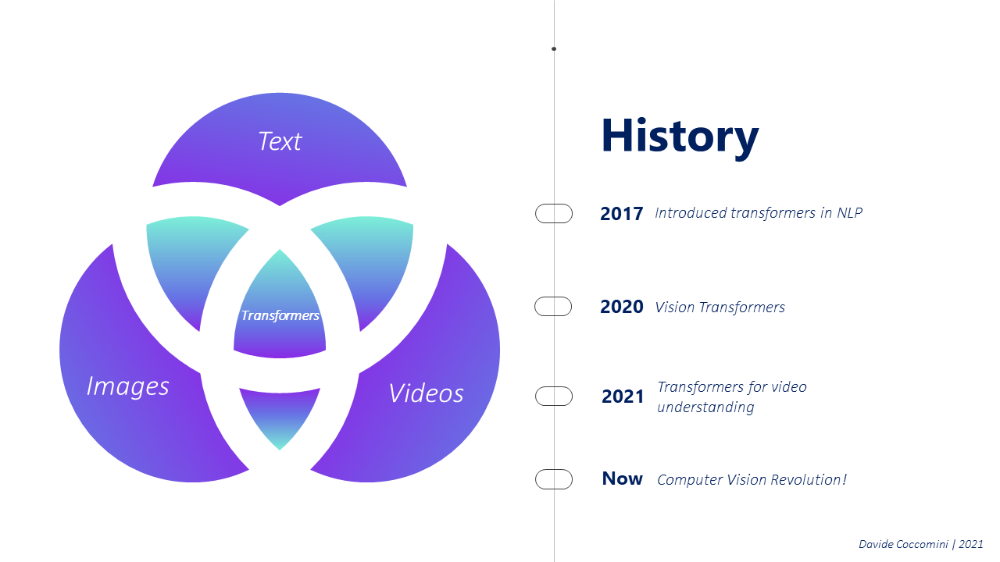

## Agenda

* Introduction to the transformer
* Understanding the encoder of the transformer
* Understanding the decoder of the transformer
* Putting the encoder and decoder together
* Training the transformer

## Introduction to the transformer
RNN and LSTM networks are widely used in sequential tasks such as next word
prediction, machine translation, text generation, and more. However one of the **major
challenges with the recurrent model is capturing the long-term dependency**

Transformers overcome this limitation using **Self Attention Mechanishm**

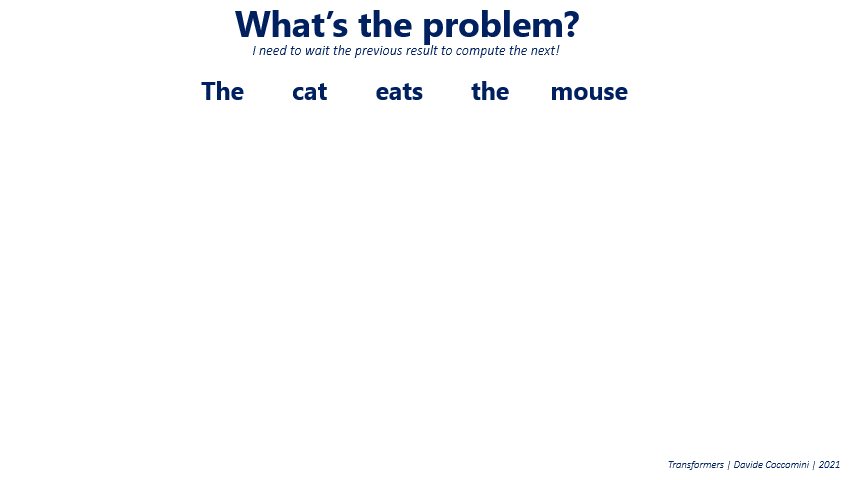

* Considering the above translation task using traditional mechanisms like RNNS would require the results from previous step in order to process the next step i.e. **sequential operation**.

* There are also other problems such as **gradient explosion**, inability to **detect dependencies between distant words** in the same sentence

* The biggest flaw here is ;in case we want to take advantage of the parallelization capability of modern GPUs we will lose out in terms of performance.

Consider the following two sentences:
* Sentence A: He got bit by Python.
* Sentence B: Python is my favorite programming language.


* Self Attention Mechanism : Here model relates each word with all other words in the sentences to understand the context of the word better

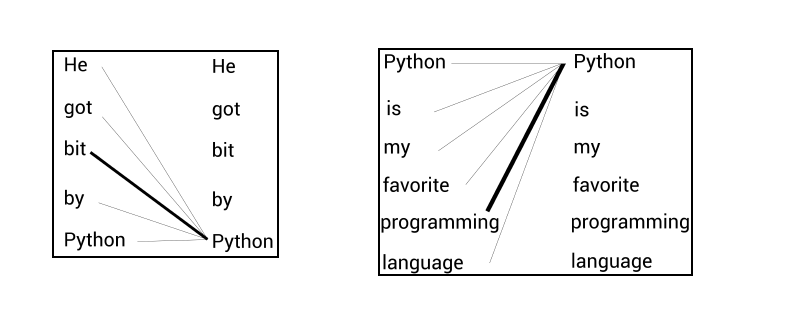

* Here python in sentence 1 referes to a snake while python in sentence 2 refers to a programming language

* Now,if we get embeddings for the word 'Python' in the preceding two sentences using an **embedding model such as word2vec**, the embedding of the word **'Python'** would be the **same** in both sentences, and so this renders the meaning of the word 'Python' the same in
both sentences.

* This is because word2vec is the context-free model, so it will ignore the context and always give the same embedding for the word 'Python' irrespective of the context.

* Transformers, on the other hand, is a context-based model. 
* It will understand the context and then
generate the embedding for the word based on the context. 
* So, for the preceding two
sentences, it will give different embeddings for the word **'Python'** based on the context.

## Why Attention

Since the paper **[Attention Is All You Need](https://proceedings.neurips.cc/paper/2017/file/3f5ee243547dee91fbd053c1c4a845aa-Paper.pdf)** came out in 2017, Attention Networks have been used widely in many fields mainly in NLP and computer vision as people understood how useful they could be.


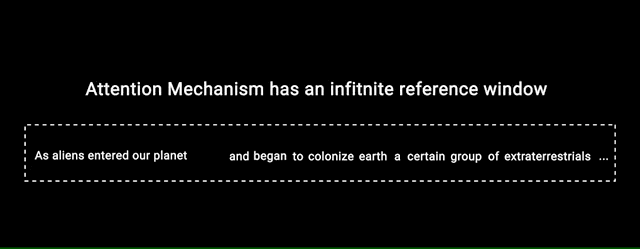

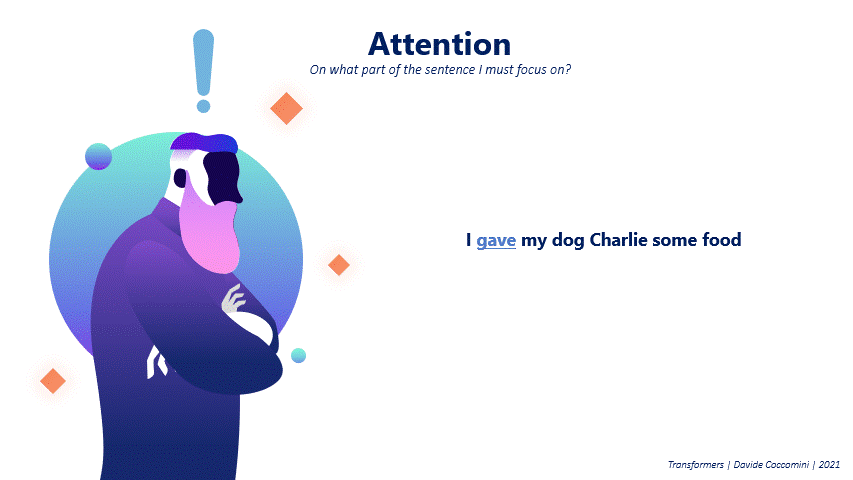


The **Attention mechanism** enables the transformers to have extremely long-term memory. A transformer model can **“attend”** or **“focus”** on all previous tokens that have been generated.

Here in order to extract information from the sentence we can apply a parallelized approach i.e. attending to a certain part in the sentence when processing large amount of informtion.

Taking the above example illustrated " I **gave** my dog Charlie some food".

Considering the word **gave** we need to decide which other words in the sentence should we focus or pay attention so that it adds meaning to this word **gave**.

In order to do this we might ask myself a series of questions :

*  who gave? And in this case,  attention will be on the word **“I”**
*  To Whom gave? here  attention in on the word **Charlie** and 

*  finally, what gave? here  attention in on the word **food**.

So by asking these questions for each of the words in the sentence, we  might be able to understand the meaning and facets

## What is Self Attention ?

Self-Attention is when it takes into consideration the relationship among words within the same sentence.

To understand this in more detail we nwe can draw parallels to the world of databases.

* When we do a search in the database we submit a query **(Q)** * we search among the available data for one or more keys **(K)** that satisfy the query. 
* The output is the value **(V)** associated with the key which is most relevant to the query.

## Example :

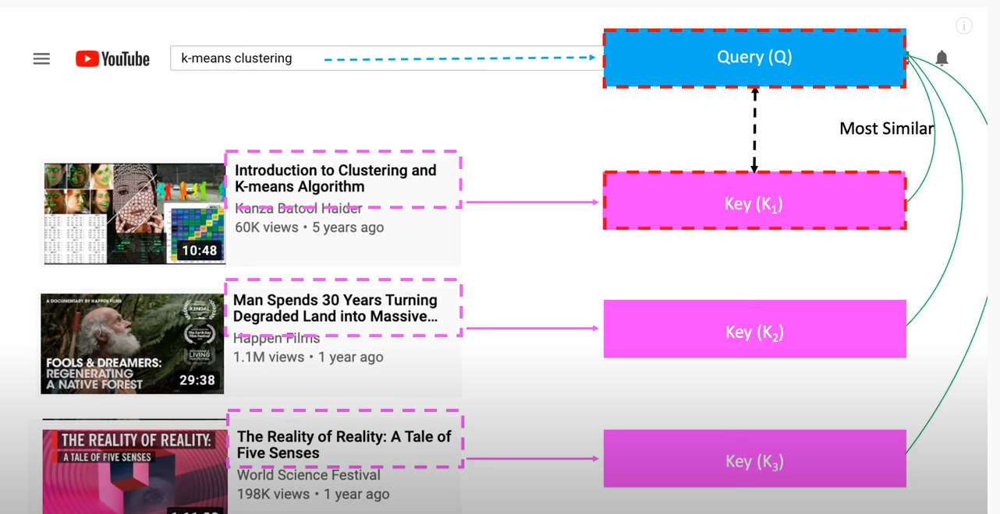

once the most similar key has been found it returns the video and we can call it as **value**

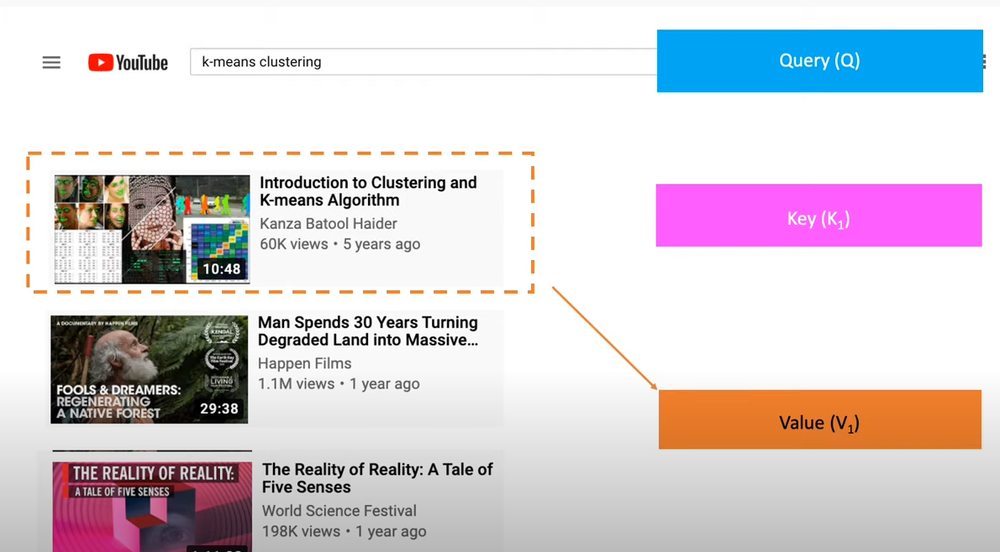


**So here similarity can be thought of as a proxy to attention**.

This is because the model returns the best video by paying attention to the most similar video title when compared to the search query


## How to we compute similarity between a Query and a Key ?

#### Cosine Similarity 

* Cosine similarity varies from a range of -1 to +1

   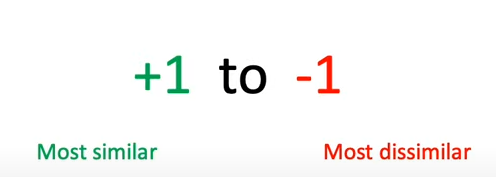


   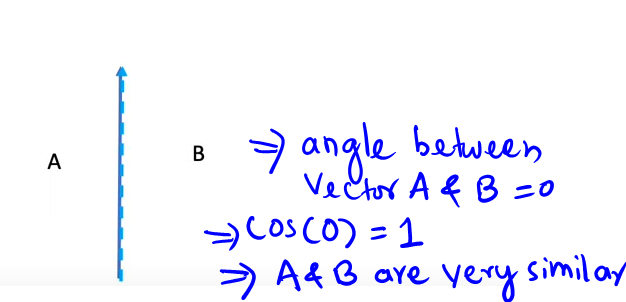

   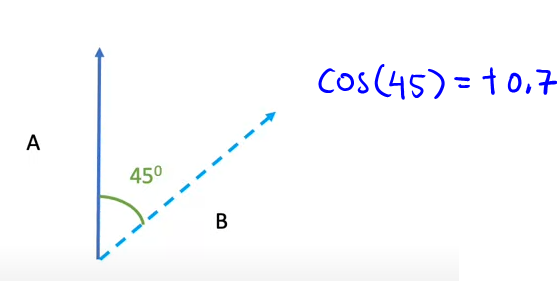

   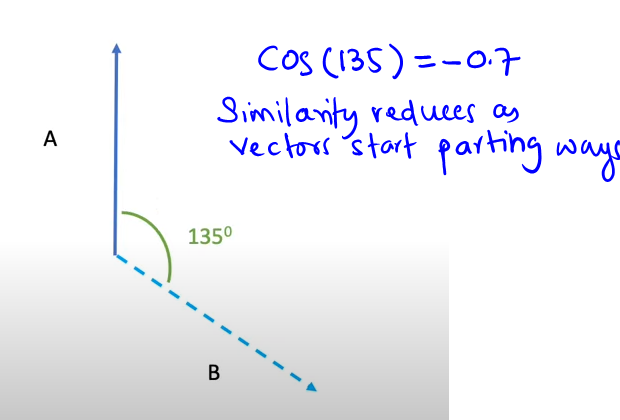


Cosine similarity is obtained by taking dot product of two vectors and dividing it by their magnitude for scaling
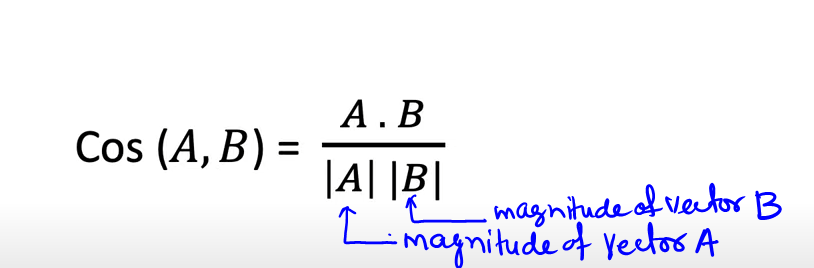

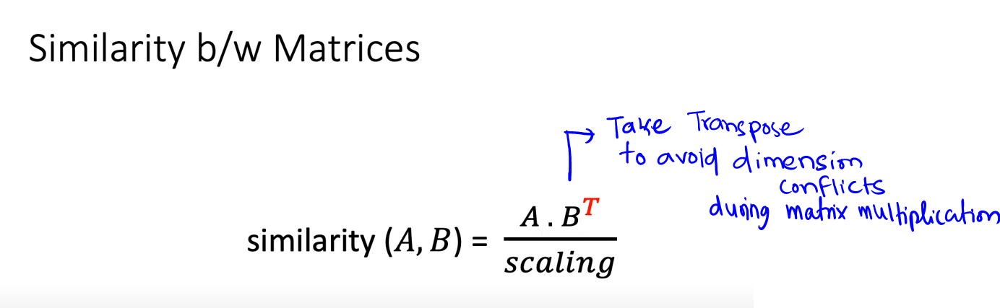

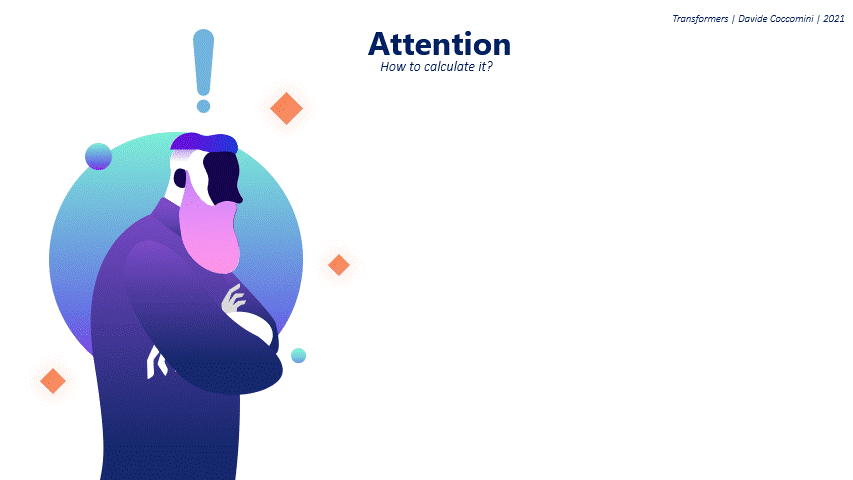

Consider the sentence : I am good

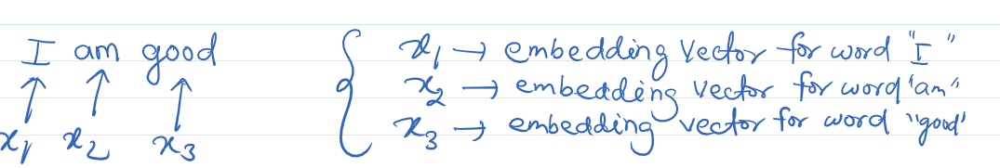

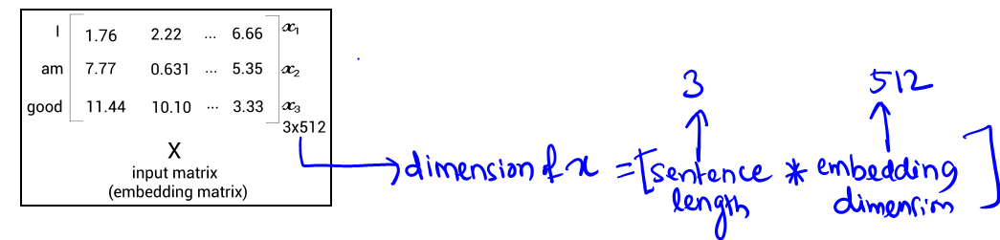

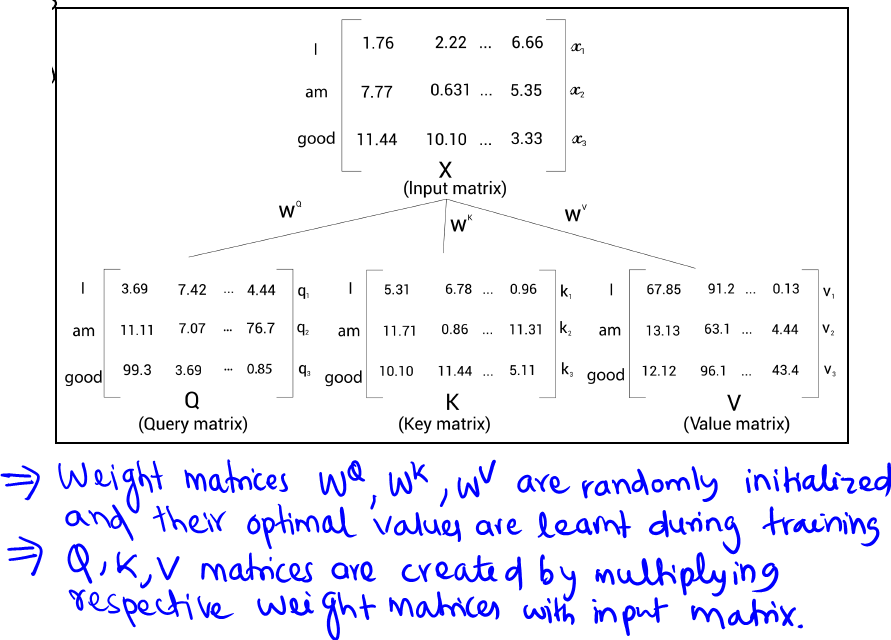

In order to compute the representation of a word the self attention mechanism relates the word to all the words in the sentence .

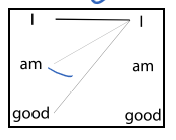



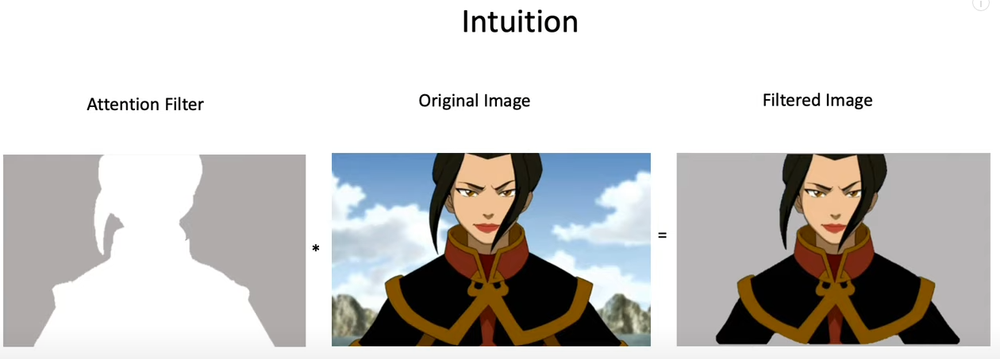

## Steps involve in Self Attention Mechanism

1. Compute dot product between Query Matrix Q and Key matrix K to get the similarity scores.
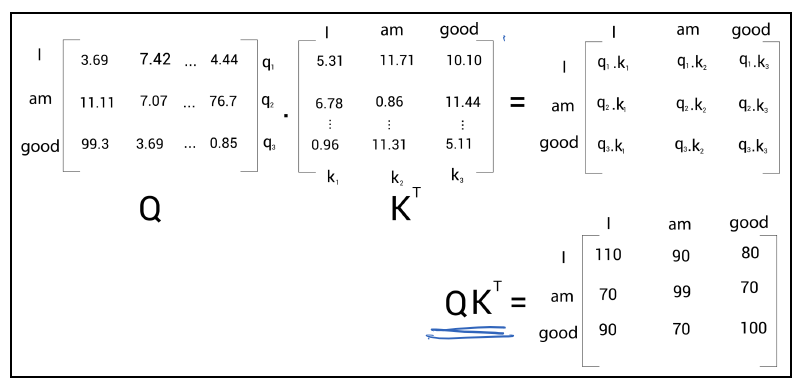

2. Obtain stable gradients


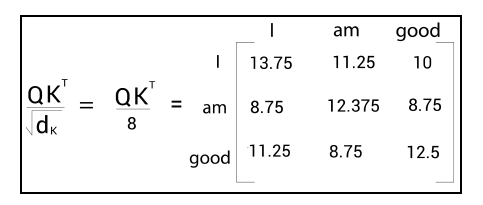

3. Normalize the scores by applying softmax to bring the scores in the range 0 to 1

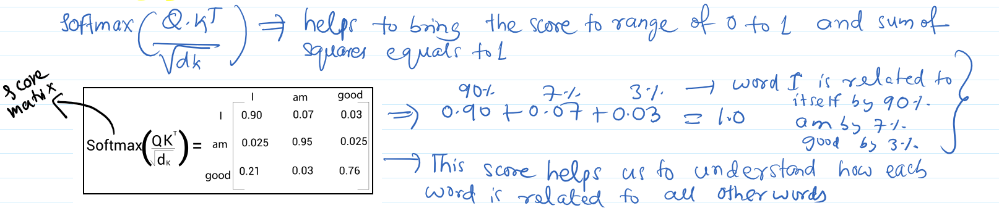

4. Compute attention matrix by applying softmax


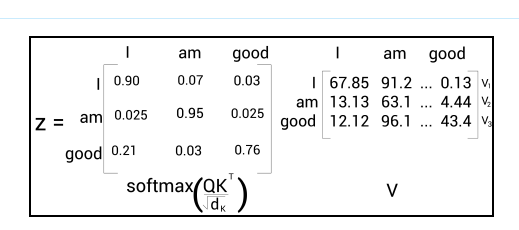



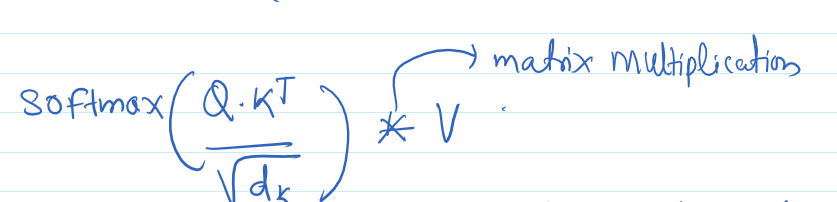

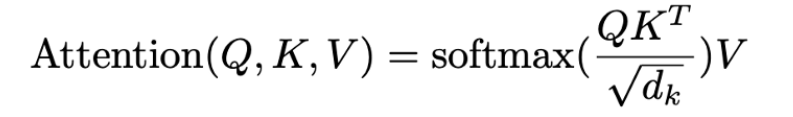

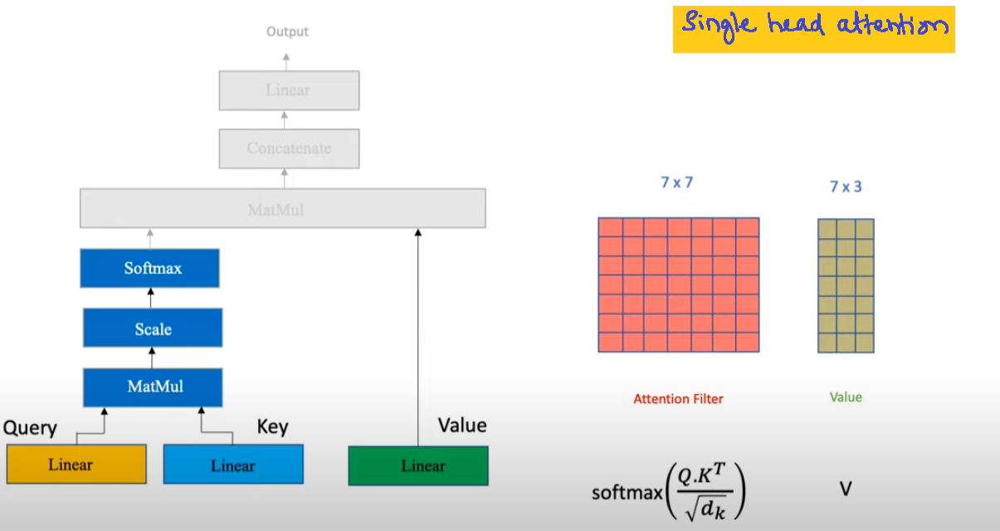

## Why Multihead attention?

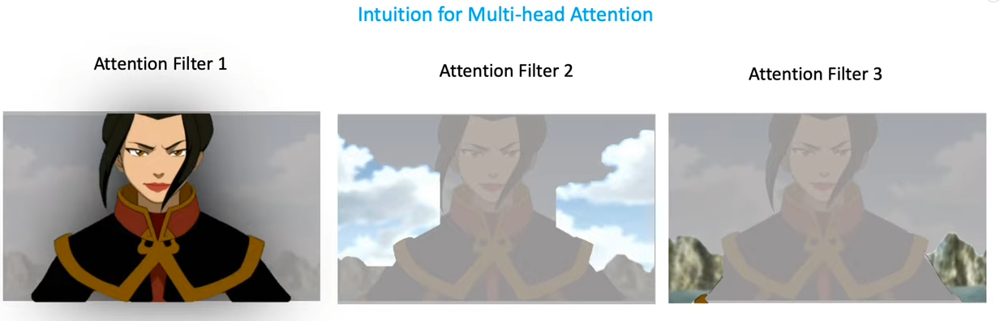

Transfmers do not learn from one attention filter. They learn from multiple attention filters to capture the linguistic importance.


When we want to look at the sentence from several points of view Multihead attention is incorporated.

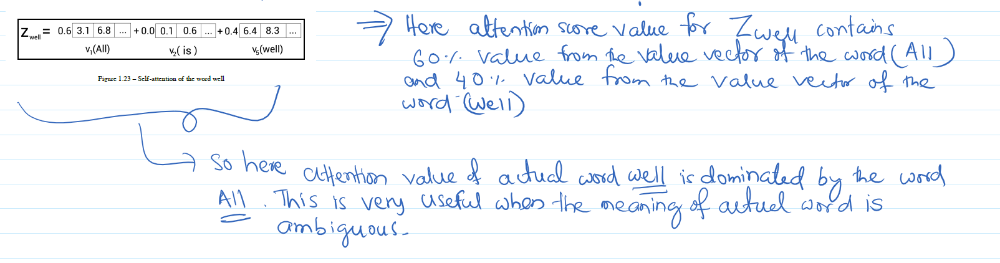

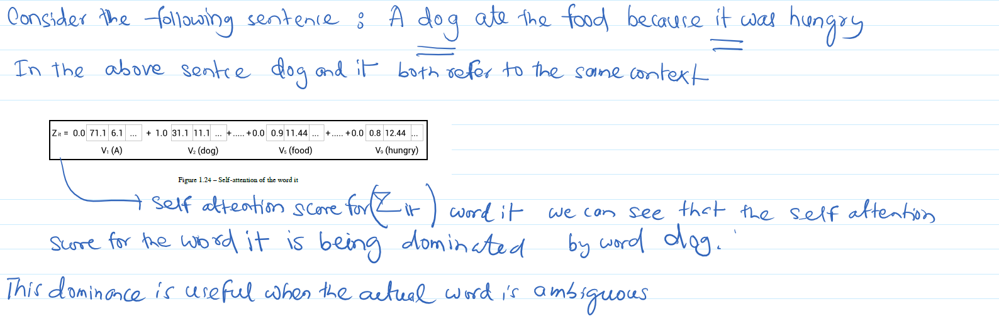

Each attention layer layer outputs its own attention filter which inturn outputs it's own filtered value matrix each zooming in on a different linguistic feature.
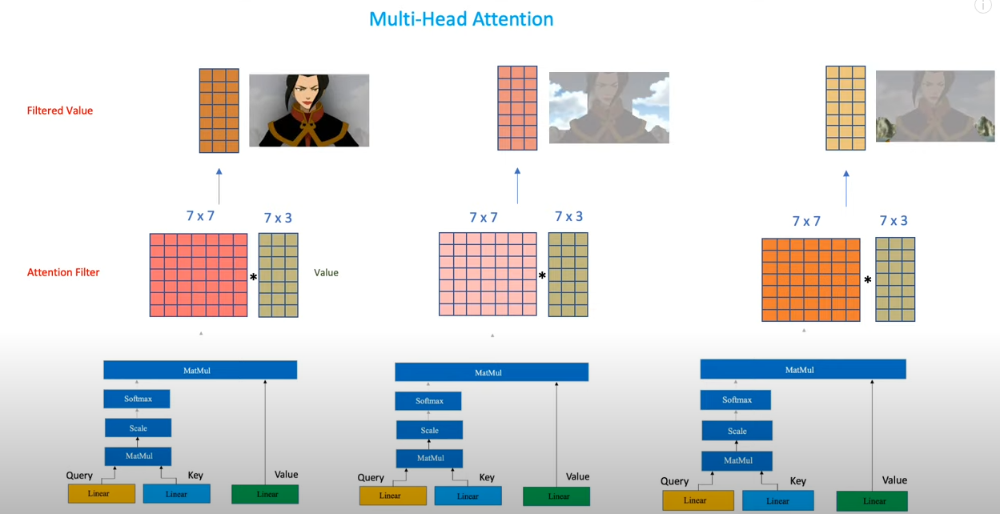

**Note** : In the original transformers paper the authors had used a total of 8 attention head.

In the above illustration there are 3 attention heads.

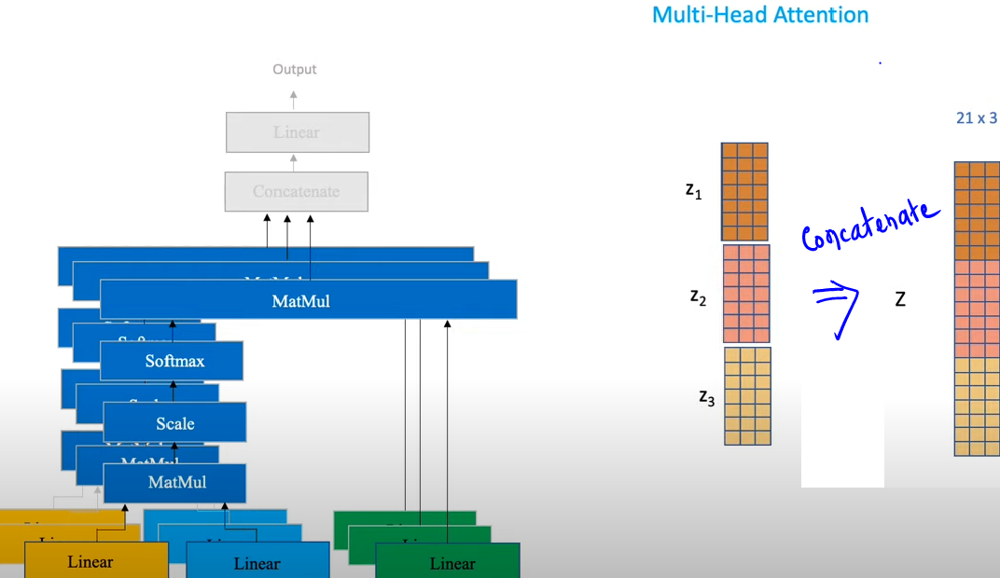

So in order to make the results more accurate ,instead of computing a single attention matrix we will compute multiple attention matrix andthen concatenate the results.

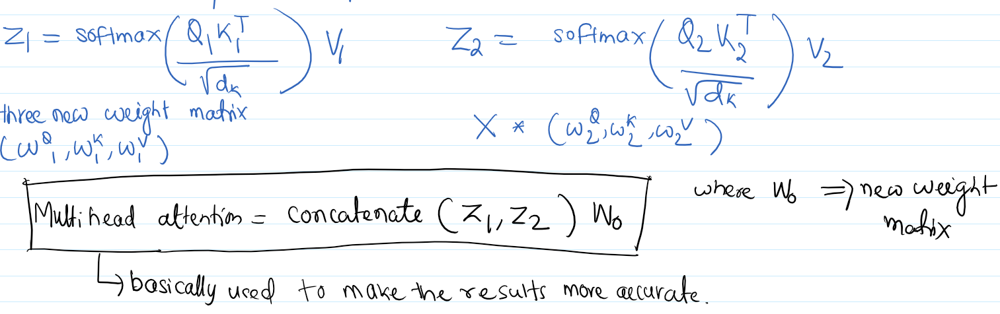

Since we do not want the output vector to grow larager and larger with the increase in the number of heads we pass it to a linear layer to shrink the size back to that of the input embedding

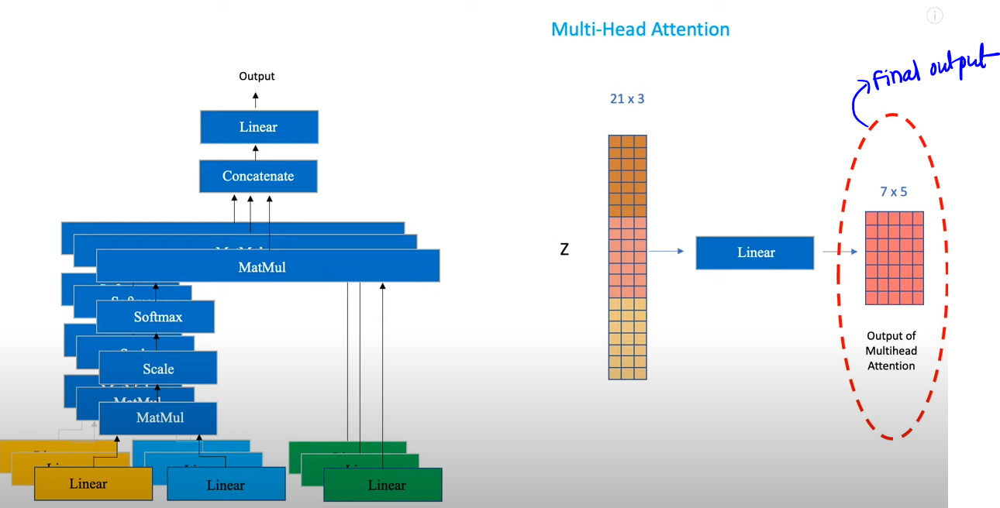

## Positional Embedding 

In transformer network instead of feeding the sentences word by word we feed the words in the sentence in parallel.This helps in decreasing training time and learning long term dependency.

The problem with this approach is that how will the transformer understand the meaning of the sentence if the order of the words is not retained . In order to retain the order of the words we use **positional encoding**.

**Positional encodig** is an encoding that indicates the position of the words in the sentence

## How Positional Embedding is Computed  ?

In transformer paper authors have used a sinusoidal functio for computing poistional encoding
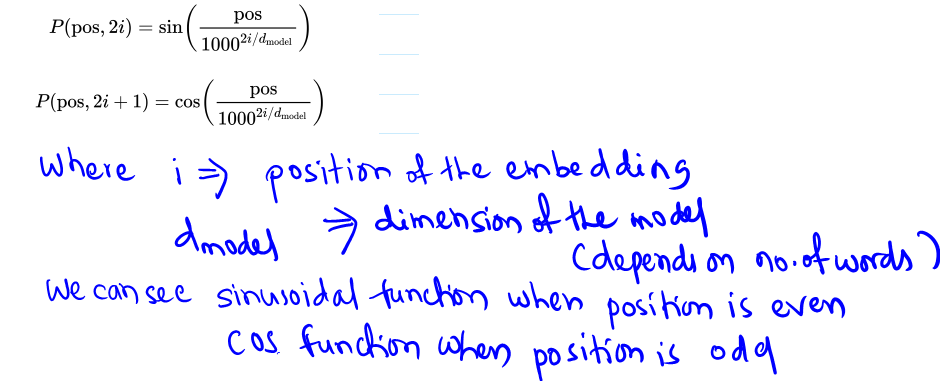

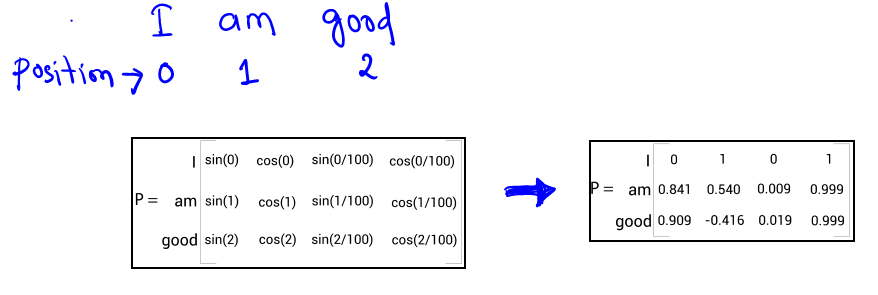

After computing positional encoding P an elementwise addition operation is performed with the input embedding matrix which becomes input to the encoder (transformer).

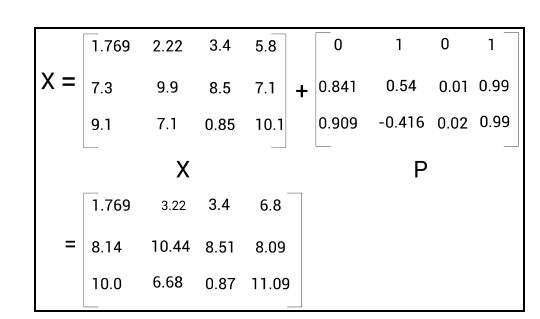

## Transformers Architecture

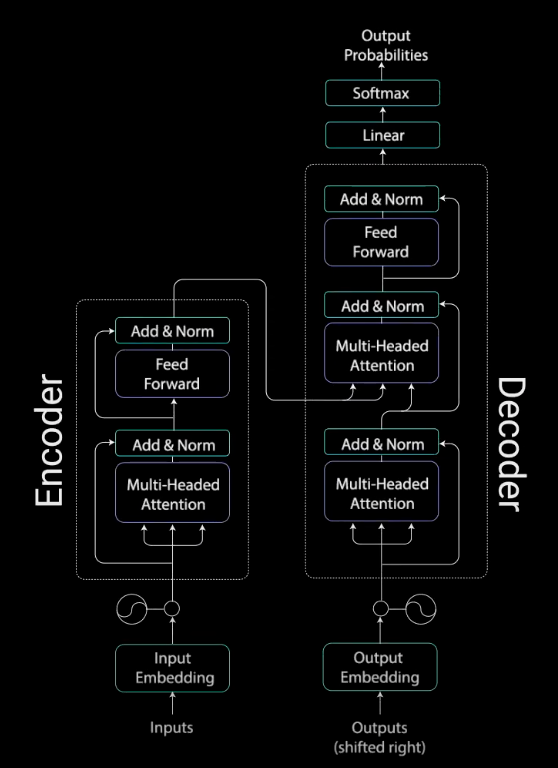

#### Transformers consists of encoder decoder architecture.

#### Flow

1.   Input is fed to the Encoder
2.   Encoder learns the representation of the input provided and sends the representation to the decoder
3.   Decoder receives the output from the encoder as input and generates the output sequence


## Residual Connections

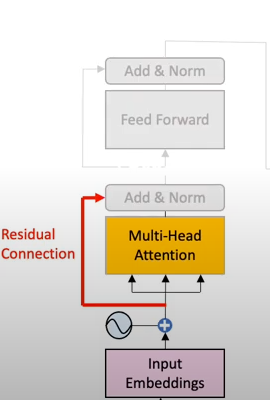

Residual connections serve two main purposes:
* Knowledge Preservation
* Vanishing Gradient Problem

## Feed Forward Layer

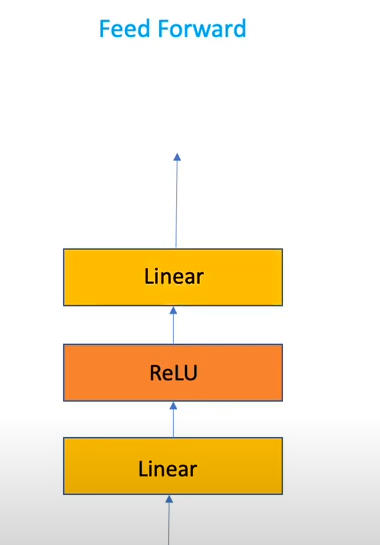

 ## Summing Up Encoder Architecture
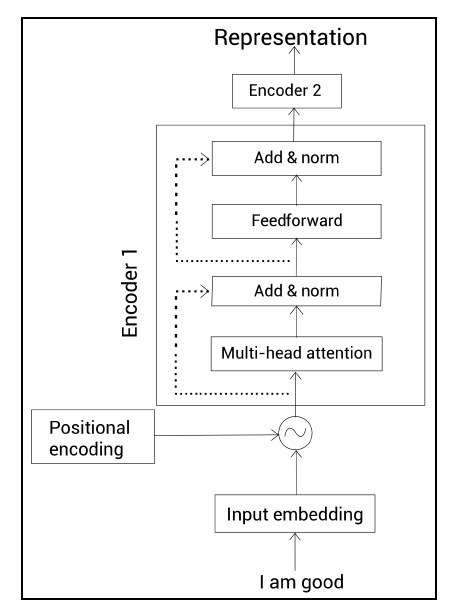


#### Steps

1. Convert the input into embedding matrix and add positional embedding and feed it to the bottomest encoder layer

2. Encoder layer takes the input and feeds it to the Multi-head attention layer which generates attention matrix as output.

3. The feedforward network takes the attention matrix as input and returns encoder representation as output.

4. The encoder pout put is then fed as input to subsequent encoder layers or the decoder .

## Decoder Architecture
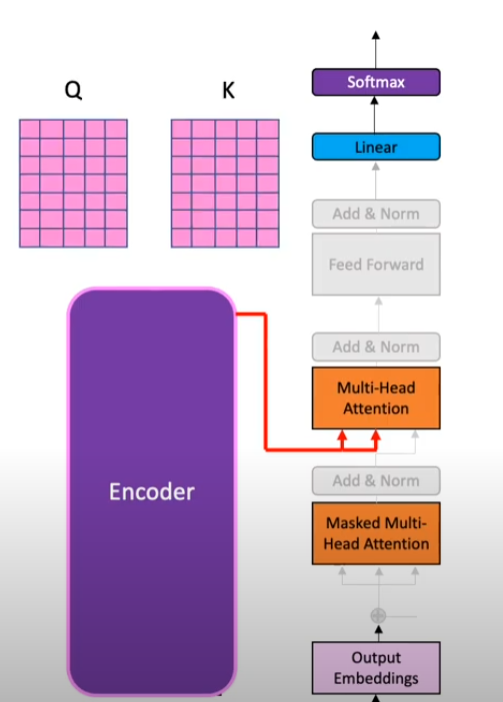



The Decoder Block consists of 
* Masked Multihead Attention
* Multihead attention
* FeedForward Network

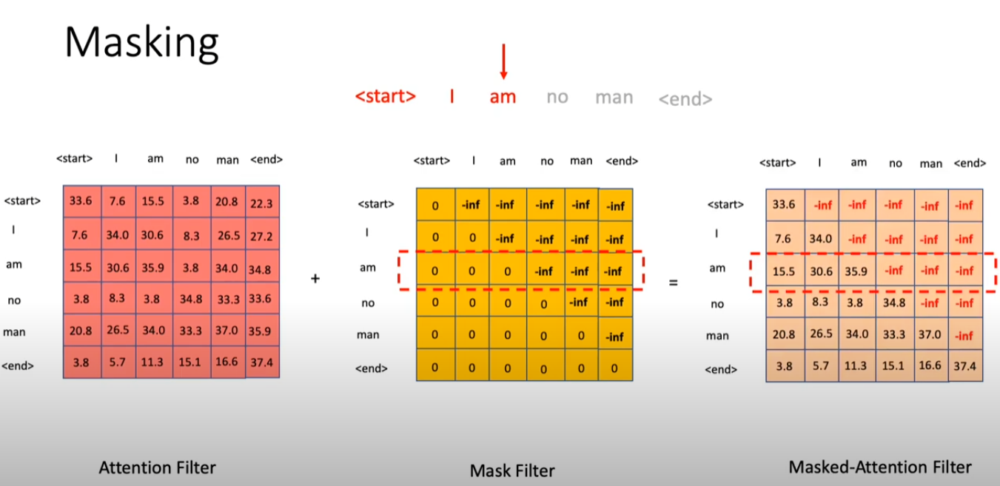

## Masked Multihead Attention Layer

* The cath over here at Masked Multi-head attention layer is that during test time the decoder will only have the words generated until previous time step as input.

For example : at time step 2 decoder will only have words ["I","am"] as a result the attention mechanism will focus on words uptill am and not other words.

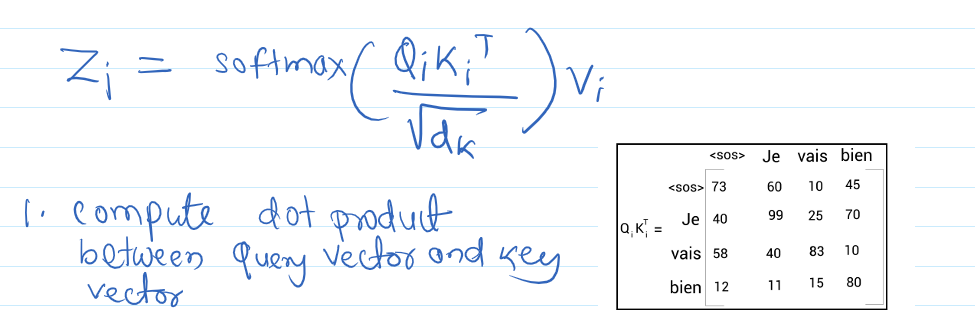

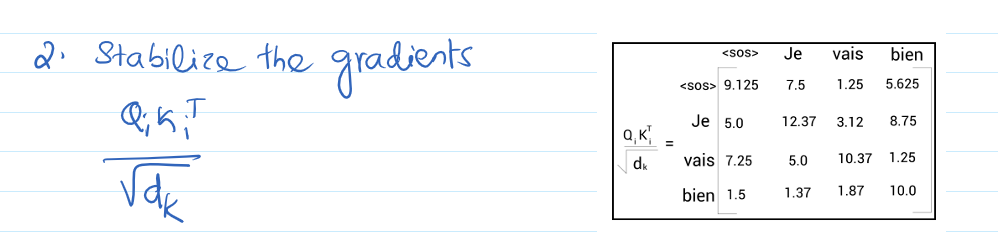

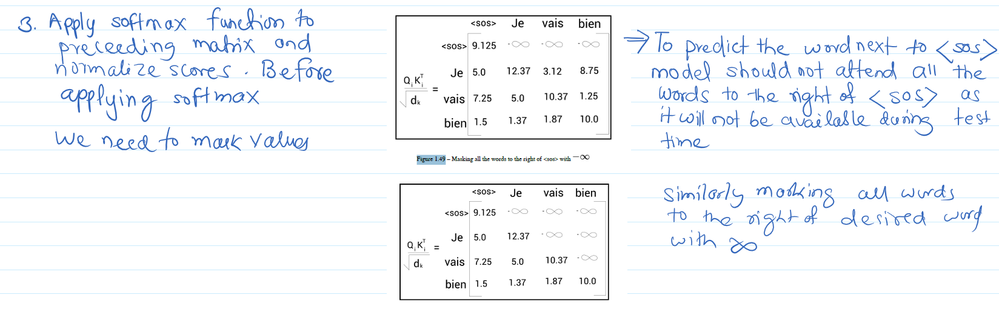

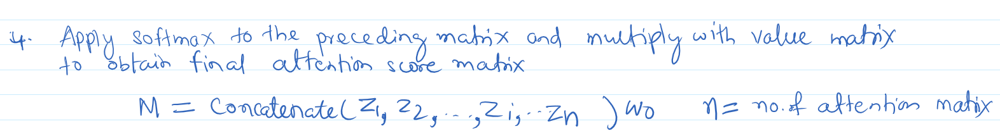

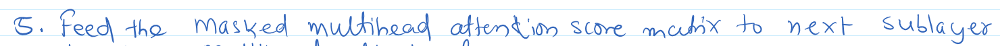

## How the multihead attention layer works ?

The decoder multihead attention layer takes two input matrices 
* Query and Key  encoder representation
* attention matrix(Value) from the previous layer

The next steps are very much similar to the processes we had in a encoder multihead attention layer.


## Summing up the Decoder

1. Convert the input text to the decoder into an embedding matrix and add poistional embedding and feed to the bottomost decoder (incase more than one decoder layer)

2. The input from the decoder is fed to the masked mult-head attenton head layer and it generates an attention matrix as output.

3. The output is then passed through the normalization layer which generates the Value Matrix.

4. The output from encoder (Query,Key matrix) and the Value matrix from thge masked multihead attention layer is fed into the multihead attention layer which outputs new attention matrix.

5. This attention matrix is then passed to the normalization layer.

6. The out put is then fed into the feed forward network which then passes the output to subsequent decoder layers.

7. Once the decoder layer learns the representaion of the target sequence fed , the output from the topmost layer is fed to a linear layer and softmax layer. Linear layer generates logits whose size is equal to the length of the vocab.

8. Convert the logits generated into a probability by applying the softmax funtion and then the decoder outputs the word that has the highest probability value

## Transformer Anatomy

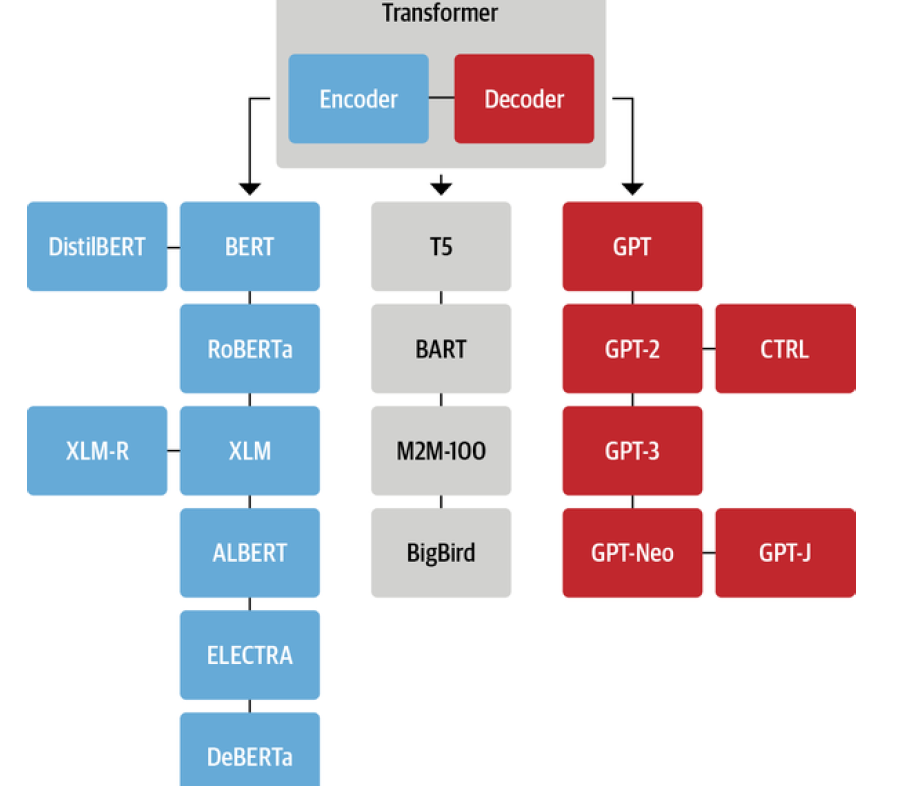

## Practical implementation using 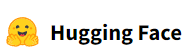



#### Hugging Face Pipelines

The pipelines are a great and easy way to use models for inference. These pipelines are objects that abstract most of the complex code from the library, offering a simple API dedicated to several tasks, including Named Entity Recognition, Masked Language Modeling, Sentiment Analysis, Feature Extraction and Question Answering.

#### Pipelines are made of:

* A tokenizer in charge of mapping raw textual input to token.
* A model to make predictions from the inputs.
* Some (optional) post processing for enhancing model’s output.

https://huggingface.co/docs/transformers/main/en/main_classes/pipelines#transformers.pipeline

## Install Transformers

In [1]:
 ! pip install -q transformers

     |████████████████████████████████| 5.3 MB 5.1 MB/s 
     |████████████████████████████████| 163 kB 68.6 MB/s 
     |████████████████████████████████| 7.6 MB 71.1 MB/s 


## Text Classification pipeline
* The pipeline abstraction is a wrapper around all the other available pipelines. 

In [ ]:
from transformers import pipeline
sentiment  = pipeline("text-classification")
sentiment("Transformers  has been a boom for text processing")

No model was supplied, defaulted to distilbert-base-uncased-finetuned-sst-2-english and revision af0f99b (https://huggingface.co/distilbert-base-uncased-finetuned-sst-2-english).
Using a pipeline without specifying a model name and revision in production is not recommended.


[{'label': 'POSITIVE', 'score': 0.9163691401481628}]

* In the above pipline  the default model used for sentiment classification is **"distilbert-base-uncased-finetuned-sst-2-english"**

* In case we want to use a specific model from the [hub](https://huggingface.co/models) you can ignore the task if the model on the hub already defines it:

In [ ]:
sentiment_pipeline = pipeline(model="roberta-large-mnli")
sentiment_pipeline("Transformers  has been a boom for text processing")

Downloading:   0%|          | 0.00/688 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/1.30k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/1.43G [00:00<?, ?B/s]

Some weights of the model checkpoint at roberta-large-mnli were not used when initializing RobertaForSequenceClassification: ['roberta.pooler.dense.weight', 'roberta.pooler.dense.bias']
- This IS expected if you are initializing RobertaForSequenceClassification from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaForSequenceClassification from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


Downloading:   0%|          | 0.00/899k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/456k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/1.36M [00:00<?, ?B/s]

[{'label': 'NEUTRAL', 'score': 0.600421667098999}]

## Text Generation Pipeline

In [ ]:
from transformers import pipeline,set_seed
generator = pipeline('text-generation')

No model was supplied, defaulted to gpt2 and revision 6c0e608 (https://huggingface.co/gpt2).
Using a pipeline without specifying a model name and revision in production is not recommended.


Downloading:   0%|          | 0.00/665 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/548M [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/1.04M [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/456k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/1.36M [00:00<?, ?B/s]

In [ ]:
set_seed(42)
generator("Imapct of AI in shaping the business,", max_length=30, num_return_sequences=5)

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


[{'generated_text': 'Imapct of AI in shaping the business, politics and government of AI. In particular:\n\nThe power of digital currencies to shift policy,'},
 {'generated_text': 'Imapct of AI in shaping the business, and in what ways.\n\nAnd how has being able to use AI have helped your company have'},
 {'generated_text': 'Imapct of AI in shaping the business, the world-wide research landscape, and the global commercial nature of AI.\n\nIn this talk'},
 {'generated_text': 'Imapct of AI in shaping the business, a more flexible approach to marketing and an emphasis on business intelligence," said Kiesewetter, chief'},
 {'generated_text': 'Imapct of AI in shaping the business, is that the best thing for our country as a whole is the idea of making sure every American gets'}]

## Text Paraphrasing

Given an input sentence, the goal of the **Paraphrase Generation** is to generate an output sentence which is semantically identical to the input sentence but contains variations in lexicon or syntax.

In [2]:
! pip install -q sentencepiece -U

     |████████████████████████████████| 1.3 MB 5.0 MB/s 


In [ ]:
from transformers import pipeline,set_seed
paraphrasing = pipeline('text2text-generation',  model = "ramsrigouthamg/t5-large-paraphraser-diverse-high-quality")
paraphrasing("paraphrase: Can you recommend some upscale restaurants in Bangalore?")


Downloading:   0%|          | 0.00/1.32k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/2.95G [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/1.86k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/792k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/1.79k [00:00<?, ?B/s]

[{'generated_text': 'paraphrasedoutput: Is there any upscale restaurants in Bangalore?'}]

## One line Summary Generation

In [ ]:
model_name = "snrspeaks/t5-one-line-summary"
paraphrasing = pipeline('text2text-generation', model = model_name)
paraphrasing("paraphrase: Many companies are interested in improving their productivity levels by implementing AI.")

[{'generated_text': 'AI-Aided Productivity: A Paraphrase'}]

## Question Generation : This task generate questions given a context.

In [ ]:
questgen = pipeline("text2text-generation", model = "valhalla/t5-base-e2e-qg")
questgen("generate questions : New Delhi is India's capital.", num_beams=4, max_length = 8)

Downloading:   0%|          | 0.00/1.35k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/892M [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/195 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/792k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/31.0 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/1.79k [00:00<?, ?B/s]

[{'generated_text': "What city is India's capital"}]

## Language Translation : translating text from one language to another

In [ ]:
text_translate = pipeline("text2text-generation") # default model t5-base
text_translate ("translate English to French: I love eating ice cream")

No model was supplied, defaulted to t5-base and revision 686f1db (https://huggingface.co/t5-base).
Using a pipeline without specifying a model name and revision in production is not recommended.


Downloading:   0%|          | 0.00/1.20k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/892M [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/792k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

/usr/local/lib/python3.7/dist-packages/transformers/models/t5/tokenization_t5_fast.py:166: FutureWarning: This tokenizer was incorrectly instantiated with a model max length of 512 which will be corrected in Transformers v5.
For now, this behavior is kept to avoid breaking backwards compatibility when padding/encoding with `truncation is True`.
- Be aware that you SHOULD NOT rely on t5-base automatically truncating your input to 512 when padding/encoding.
- If you want to encode/pad to sequences longer than 512 you can either instantiate this tokenizer with `model_max_length` or pass `max_length` when encoding/padding.
- To avoid this warning, please instantiate this tokenizer with `model_max_length` set to your preferred value.
  FutureWarning,


[{'generated_text': "J'aime manger de la crème glacée"}]

In [ ]:
text_translate ("translate English to German: I love eating ice cream")

[{'generated_text': 'Ich liebe Eiscreme'}]

## Extractive Question Answering : Question-answering is the task of extracting answers from a tuple of a candidate paragraph and a question.

In [ ]:
question_answerer = pipeline("question-answering")

No model was supplied, defaulted to distilbert-base-cased-distilled-squad and revision 626af31 (https://huggingface.co/distilbert-base-cased-distilled-squad).
Using a pipeline without specifying a model name and revision in production is not recommended.


Downloading:   0%|          | 0.00/473 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/261M [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/29.0 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/213k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/436k [00:00<?, ?B/s]

In [ ]:
context ="""Two years and a few months on, India’s decision to “demonetize” some of its currency is still having lasting effects on the economy. Demonetization refers to the process of stripping a currency unit of its status as a legal tender. In the Indian context, this meant rendering the INR 500 and INR1000 notes invalid past midnight November 8, 2016. This decision was announced by the Prime Minister of India, Narendra Modi, who stated that the primary reason to combat black market activity and counterfeit bills. As India is an economy largely dependent on cash, this decision certainly came as a significant one."""

In [ ]:
result = question_answerer(question="When did INR 500 notes become invalid ?", context=context)

In [ ]:
result

{'score': 0.5357615351676941,
 'start': 328,
 'end': 344,
 'answer': 'November 8, 2016'}

## Text Summarization

In [ ]:
text = """Demonetization is a form of economic intervention, where a country moves to replace one form of currency with another. At the beginning of the demonetization process, the old currency is discontinued and pulled from circulation to be replaced with new forms of money.
During the process, people are given time to exchange their existing banknotes and coins for the new currency before it is officially discontinued. After a currency has been discontinued, it is no longer legal tender and contains no monetary value."""

In [ ]:
summarizer = pipeline("summarization")# default model distilbart-cnn-12-6
summarizer(text, min_length=5, max_length=20)

No model was supplied, defaulted to sshleifer/distilbart-cnn-12-6 and revision a4f8f3e (https://huggingface.co/sshleifer/distilbart-cnn-12-6).
Using a pipeline without specifying a model name and revision in production is not recommended.


Downloading:   0%|          | 0.00/1.80k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/1.22G [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/26.0 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/899k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/456k [00:00<?, ?B/s]

[{'summary_text': ' Demonetization is a form of economic intervention where a country replaces one form of currency'}]

## Named Entity Recognition

In [ ]:
nER= pipeline("ner") # default model
sentence = 'Steve Job  is an owner and co-founder of Apple.'
nER(sentence)

No model was supplied, defaulted to dbmdz/bert-large-cased-finetuned-conll03-english and revision f2482bf (https://huggingface.co/dbmdz/bert-large-cased-finetuned-conll03-english).
Using a pipeline without specifying a model name and revision in production is not recommended.


[{'entity': 'I-PER',
  'score': 0.9986965,
  'index': 1,
  'word': 'Steve',
  'start': 0,
  'end': 5},
 {'entity': 'I-PER',
  'score': 0.9994173,
  'index': 2,
  'word': 'Job',
  'start': 6,
  'end': 9},
 {'entity': 'I-ORG',
  'score': 0.99874276,
  'index': 11,
  'word': 'Apple',
  'start': 41,
  'end': 46}]

## Image Classification

In [ ]:
! wget https://img.rasset.ie/000214ae-1600.jpg

--2022-10-24 15:09:34--  https://img.rasset.ie/000214ae-1600.jpg
Resolving img.rasset.ie (img.rasset.ie)... 104.19.180.121, 104.19.179.121, 2606:4700::6813:b479, ...
Connecting to img.rasset.ie (img.rasset.ie)|104.19.180.121|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: unspecified [image/jpeg]
Saving to: ‘000214ae-1600.jpg’

000214ae-1600.jpg       [ <=>                ] 272.97K  --.-KB/s    in 0.01s   

2022-10-24 15:09:34 (23.8 MB/s) - ‘000214ae-1600.jpg’ saved [279517]



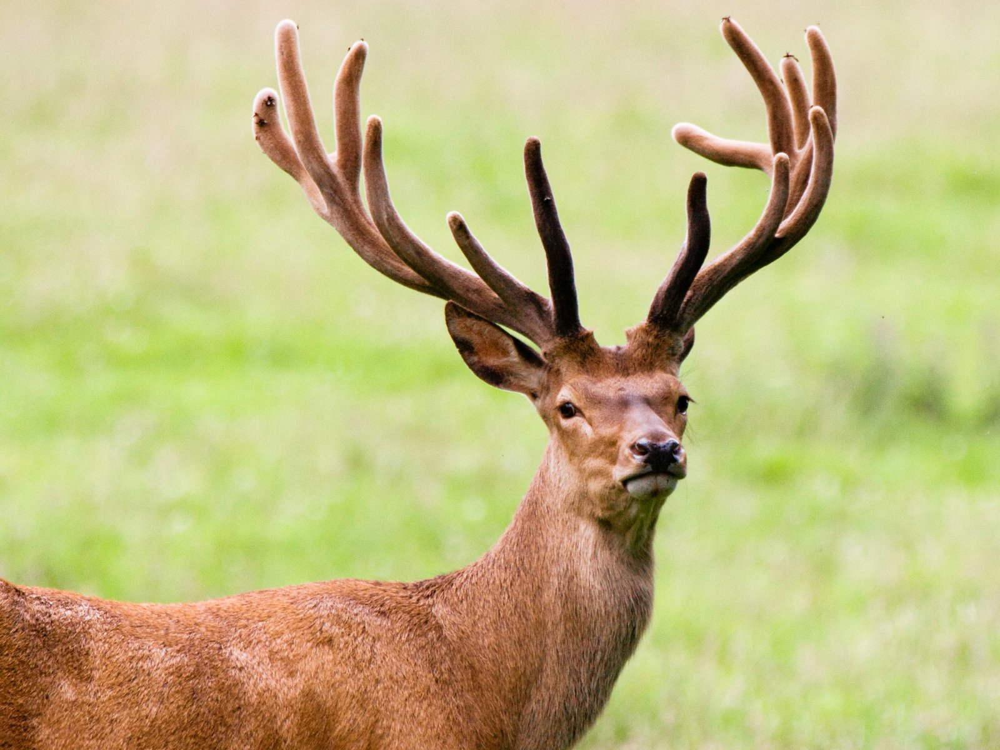

In [ ]:
import cv2 
from google.colab.patches import cv2_imshow
image = cv2.imread("/content/000214ae-1600.jpg")
cv2_imshow(image)

In [ ]:
vision_classifier = pipeline(task="image-classification")

No model was supplied, defaulted to google/vit-base-patch16-224 and revision 5dca96d (https://huggingface.co/google/vit-base-patch16-224).
Using a pipeline without specifying a model name and revision in production is not recommended.


Downloading:   0%|          | 0.00/69.7k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/346M [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/160 [00:00<?, ?B/s]

In [ ]:
data = "https://img.rasset.ie/000214ae-1600.jpg"
vision_classifier(images=data)

[{'score': 0.35561603307724, 'label': 'gazelle'},
 {'score': 0.1152384951710701, 'label': 'impala, Aepyceros melampus'},
 {'score': 0.06410863250494003, 'label': 'hartebeest'},
 {'score': 0.018890155479311943, 'label': 'ibex, Capra ibex'},
 {'score': 0.01778068207204342, 'label': 'bison'}]

## Image Captioning

--2022-10-24 15:26:53--  https://handluggageonly.co.uk/wp-content/uploads/2016/03/IMG_1717.jpg
Resolving handluggageonly.co.uk (handluggageonly.co.uk)... 45.79.155.6
Connecting to handluggageonly.co.uk (handluggageonly.co.uk)|45.79.155.6|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 480120 (469K) [image/jpeg]
Saving to: ‘img2text.jpg’

img2text.jpg        100%[===================>] 468.87K   566KB/s    in 0.8s    

2022-10-24 15:26:55 (566 KB/s) - ‘img2text.jpg’ saved [480120/480120]



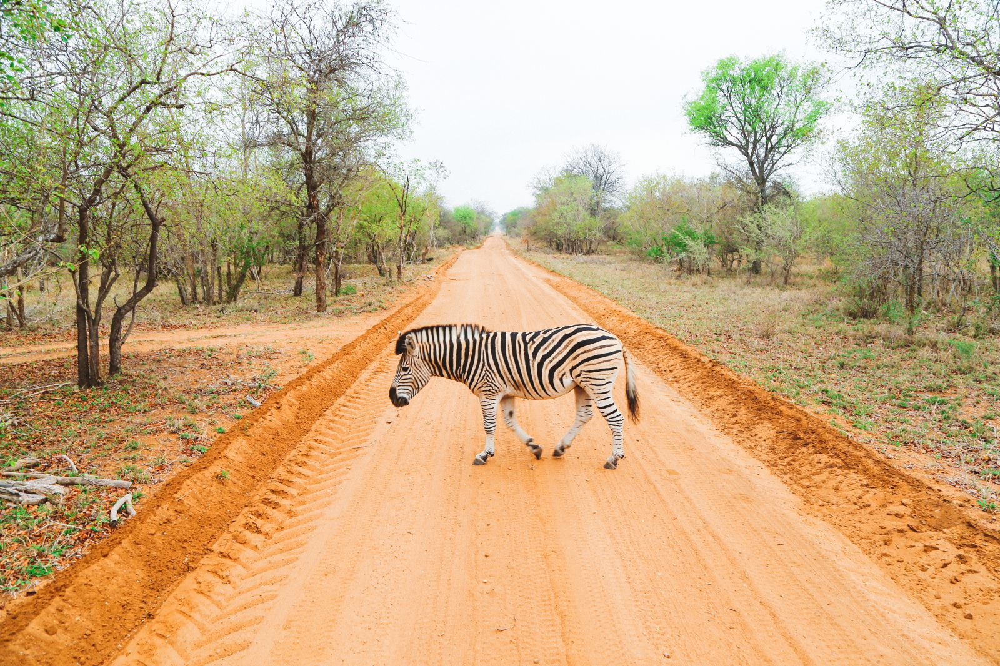

In [ ]:
!wget -O img2text.jpg 'https://handluggageonly.co.uk/wp-content/uploads/2016/03/IMG_1717.jpg'

from IPython.display import Image
Image(filename='img2text.jpg')

In [ ]:
caption = pipeline('image-to-text')# defualt model vit-gpt2-coco-en

No model was supplied, defaulted to ydshieh/vit-gpt2-coco-en and revision 65636df (https://huggingface.co/ydshieh/vit-gpt2-coco-en).
Using a pipeline without specifying a model name and revision in production is not recommended.


Downloading:   0%|          | 0.00/4.34k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/982M [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/236 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/798k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/456k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/1.36M [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/120 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/211 [00:00<?, ?B/s]

In [ ]:
caption('img2text.jpg')

/usr/local/lib/python3.7/dist-packages/transformers/generation_utils.py:1301: UserWarning: Neither `max_length` nor `max_new_tokens` has been set, `max_length` will default to 20 (`self.config.max_length`). Controlling `max_length` via the config is deprecated and `max_length` will be removed from the config in v5 of Transformers -- we recommend using `max_new_tokens` to control the maximum length of the generation.
  UserWarning,


[{'generated_text': 'a zebra walking down a dirt road '}]

## Object Detection Pipeline

In [ ]:
! pip install -q timm

     |████████████████████████████████| 548 kB 3.9 MB/s 


In [ ]:
objdect = pipeline("object-detection",model="hustvl/yolos-base")

Downloading:   0%|          | 0.00/4.13k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/511M [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/275 [00:00<?, ?B/s]

In [ ]:
! wget https://1.bp.blogspot.com/-2wyrfJjwJNw/Tpl2SKqQMkI/AAAAAAAADK8/I60vt30Rf6E/s1600/traffic+signal.jpg

--2022-10-24 16:19:04--  https://1.bp.blogspot.com/-2wyrfJjwJNw/Tpl2SKqQMkI/AAAAAAAADK8/I60vt30Rf6E/s1600/traffic+signal.jpg
Resolving 1.bp.blogspot.com (1.bp.blogspot.com)... 74.125.204.132, 2404:6800:4008:c04::84
Connecting to 1.bp.blogspot.com (1.bp.blogspot.com)|74.125.204.132|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 275376 (269K) [image/jpeg]
Saving to: ‘traffic+signal.jpg’

traffic+signal.jpg  100%[===================>] 268.92K  --.-KB/s    in 0.002s  

2022-10-24 16:19:04 (146 MB/s) - ‘traffic+signal.jpg’ saved [275376/275376]



In [ ]:
result = objdect("/content/traffic+signal.jpg")

/usr/local/lib/python3.7/dist-packages/transformers/models/yolos/feature_extraction_yolos.py:681: FutureWarning: `post_process` is deprecated and will be removed in v5 of Transformers, please use `post_process_object_detection`
  FutureWarning,


In [ ]:
bbox =[]
score = []
label= []
for items in result:
  score.append(items['score'])
  label.append(items['label'])
  tmp_box = [v for k,v in items['box'].items()]
  print(items['box'])
  bbox.append(tmp_box)

{'xmin': 287, 'ymin': 769, 'xmax': 319, 'ymax': 799}
{'xmin': 1172, 'ymin': 755, 'xmax': 1255, 'ymax': 846}
{'xmin': 476, 'ymin': 732, 'xmax': 975, 'ymax': 1085}
{'xmin': 328, 'ymin': 762, 'xmax': 387, 'ymax': 811}
{'xmin': 500, 'ymin': 737, 'xmax': 570, 'ymax': 843}
{'xmin': 217, 'ymin': 721, 'xmax': 327, 'ymax': 850}
{'xmin': 599, 'ymin': 713, 'xmax': 632, 'ymax': 741}
{'xmin': 1208, 'ymin': 747, 'xmax': 1411, 'ymax': 889}
{'xmin': 1433, 'ymin': 750, 'xmax': 1541, 'ymax': 807}
{'xmin': 1, 'ymin': 704, 'xmax': 384, 'ymax': 1095}
{'xmin': 1070, 'ymin': 485, 'xmax': 1131, 'ymax': 609}
{'xmin': 1326, 'ymin': 223, 'xmax': 1382, 'ymax': 405}
{'xmin': 1017, 'ymin': 710, 'xmax': 1174, 'ymax': 933}
{'xmin': 1380, 'ymin': 179, 'xmax': 1463, 'ymax': 383}
{'xmin': 876, 'ymin': 707, 'xmax': 980, 'ymax': 877}


/usr/local/lib/python3.7/dist-packages/torchvision/utils.py:237: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


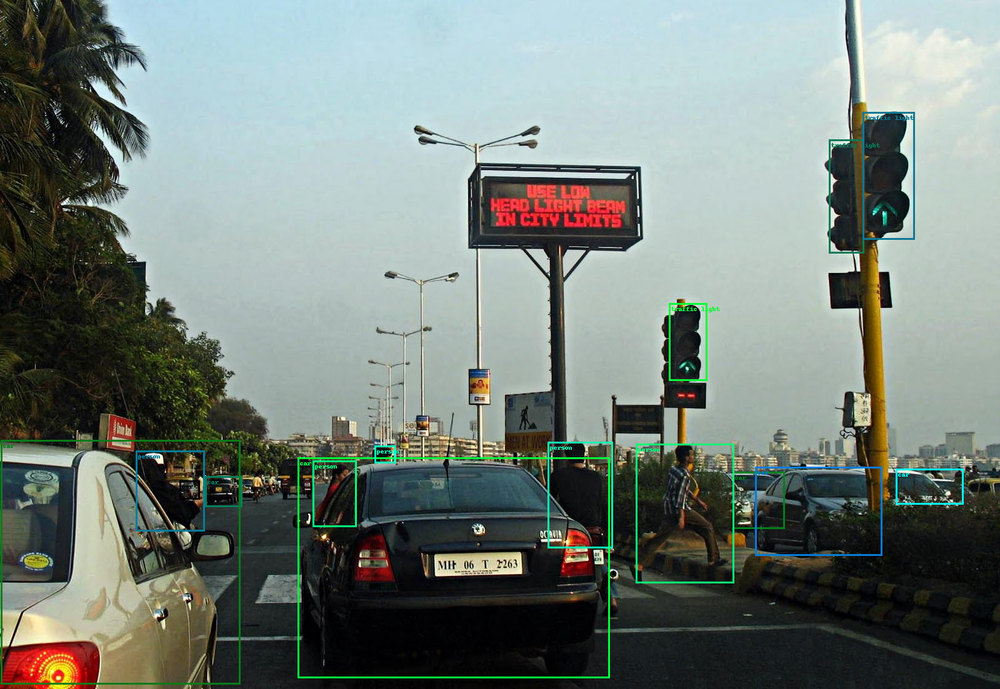

In [ ]:
import torch
import torchvision
from torchvision.io import read_image
from torchvision.utils import draw_bounding_boxes
#
# draw bounding boxes with fill color
img = read_image('/content/traffic+signal.jpg')
bbox = torch.tensor(bbox, dtype=torch.int)
#print(bbox)
#print(bbox.size())
img=draw_bounding_boxes(img, bbox,width=3,labels= label,font_size=150)
img = torchvision.transforms.ToPILImage()(img)
img

## Implementing other models apart from Transformers Pipeline

#### Abstractive Summarization

In [1]:
from transformers import PegasusForConditionalGeneration, PegasusTokenizer

#### Load Tokenizer and Model

In [2]:
tokenizer_model = PegasusTokenizer.from_pretrained("google/pegasus-xsum")

Downloading:   0%|          | 0.00/1.91M [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/65.0 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/87.0 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/1.39k [00:00<?, ?B/s]

In [3]:
loaded_model = PegasusForConditionalGeneration.from_pretrained("google/pegasus-xsum")

Downloading:   0%|          | 0.00/2.28G [00:00<?, ?B/s]

## Text on which summarization needs to be made

In [4]:
text = """Hugging Face is a great open-source library that is doing powerful work in the Natural Language Processing (NLP) space. 
The library has a bunch of pre-trained models which you can leverage or fine-tune. 

The library has many models including BERT and GPT-2 models that perform various tasks, but for our purpose, we’ll be leveraging the pre-trained language pipeline. 
Rather than going ahead and training a huge language model such as GPT-2 with 1.5 billion parameters, one can leverage the ML pipeline instead."""

In [5]:
tokens = tokenizer_model(text, truncation=True, padding="longest", return_tensors="pt")
tokens

{'input_ids': tensor([[ 1176, 73940,  8515,   117,   114,   255,   428,   121,  9534,  2400,
           120,   117,   557,  1512,   201,   115,   109,  4284,  7148, 11430,
           143, 72237,   158,   501,   107,   139,  2400,   148,   114,  4371,
           113,  1133,   121, 14787,  1581,   162,   119,   137,  7043,   132,
          1226,   121, 20619,   107,   139,  2400,   148,   223,  1581,   330,
           110, 62613,   111,  9688,   930,  5729,  1581,   120,  1798,   623,
          2722,   108,   155,   118,   150,  1396,   108,   145,   123,   267,
           129, 15479,   109,  1133,   121, 14787,  1261,  7684,   107,  7430,
           197,   313,  1573,   111,   569,   114,  1124,  1261,   861,   253,
           130,  9688,   930,  5729,   122,  5594,  1722,  5384,   108,   156,
           137,  7043,   109, 22099,  7684,  1088,   107,     1]]), 'attention_mask': tensor([[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
         1, 1, 1, 1, 1, 1, 1,

In [6]:
summary = loaded_model.generate(**tokens)
summary

/usr/local/lib/python3.7/dist-packages/transformers/generation_utils.py:1301: UserWarning: Neither `max_length` nor `max_new_tokens` has been set, `max_length` will default to 64 (`self.config.max_length`). Controlling `max_length` via the config is deprecated and `max_length` will be removed from the config in v5 of Transformers -- we recommend using `max_new_tokens` to control the maximum length of the generation.
  UserWarning,


tensor([[    0,   222,   136,   450,   108,   125,   123,   208,   313,   112,
           403,   119,   199,   112,   207,   109,  1176, 73940,  8515,  2400,
           112,  1976, 22099,  1581,   107,     1]])

In [7]:
summary[0]

tensor([    0,   222,   136,   450,   108,   125,   123,   208,   313,   112,
          403,   119,   199,   112,   207,   109,  1176, 73940,  8515,  2400,
          112,  1976, 22099,  1581,   107,     1])

In [8]:
tokenizer_model.decode(summary[0])

'In this post, I’m going to show you how to use the Hugging Face library to train ML models.'

## Setting max_length to 80, default length set to 64

In [15]:
tokens = tokenizer_model(text, truncation=True, padding="longest", return_tensors="pt",max_length=80)

In [16]:
summary = loaded_model.generate(**tokens)
summary[0]

tensor([    0,   222,   136,   755,   108,   145,   123,   267,   129,   761,
          109,  1176, 73940,  8515,  2400,   107,     1])

In [17]:
tokenizer_model.decode(summary[0])

'In this class, we’ll be learning the Hugging Face library.'

## Fine Tuning Transformers

## Fine Tune Transformers Model like BERT on Custom Dataset.

In [ ]:
!pip install transformers -U

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 4.9 MB 2.1 MB/s 
     |████████████████████████████████| 6.6 MB 55.2 MB/s 
     |████████████████████████████████| 163 kB 92.4 MB/s 


## Dataset
https://www.kaggle.com/competitions/jigsaw-toxic-comment-classification-challenge/data

## Download dataset from kaggle

In [ ]:
from google.colab import files
files.upload()

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"plabannayak","key":"f1f19a1783935d871fc0049a716ef3a8"}'}

In [ ]:
!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

In [ ]:
!kaggle competitions download -c jigsaw-toxic-comment-classification-challenge

 93% 49.0M/52.6M [00:01<00:00, 43.4MB/s]
100% 52.6M/52.6M [00:01<00:00, 37.2MB/s]


In [ ]:
!mkdir Data

In [ ]:
!unzip /content/jigsaw-toxic-comment-classification-challenge.zip 

Archive:  /content/jigsaw-toxic-comment-classification-challenge.zip
  inflating: sample_submission.csv.zip  
  inflating: test.csv.zip            
  inflating: test_labels.csv.zip     
  inflating: train.csv.zip           


In [ ]:
!unzip "/content/train.csv.zip" -d "/content/Data"

Archive:  /content/train.csv.zip
  inflating: /content/Data/train.csv  


In [ ]:
!unzip "/content/test.csv.zip" -d "/content/Data"

Archive:  /content/test.csv.zip
  inflating: /content/Data/test.csv  


In [ ]:
!unzip "/content/test_labels.csv.zip" -d "/content/Data"

Archive:  /content/test_labels.csv.zip
  inflating: /content/Data/test_labels.csv  


## Import Drive

In [ ]:
from google.colab import drive
drive.mount("/content/drive")

Mounted at /content/drive


In [ ]:
import shutil
shutil.move("/content/Data/","/content/drive/MyDrive/Qualcom")

'/content/drive/MyDrive/Qualcom/Data'

In [ ]:
import pandas as pd
data = pd.read_csv("/content/drive/MyDrive/Qualcom/Data/train.csv")
data.head()

,id,comment_text,toxic,severe_toxic,obscene,threat,insult,identity_hate
0,0000997932d777bf,Explanation\nWhy the edits made under my usern...,0,0,0,0,0,0
1,000103f0d9cfb60f,D'aww! He matches this background colour I'm s...,0,0,0,0,0,0
2,000113f07ec002fd,"Hey man, I'm really not trying to edit war. It...",0,0,0,0,0,0
3,0001b41b1c6bb37e,"""\nMore\nI can't make any real suggestions on ...",0,0,0,0,0,0
4,0001d958c54c6e35,"You, sir, are my hero. Any chance you remember...",0,0,0,0,0,0


In [ ]:
data.shape

(159571, 8)

In [ ]:
data['toxic'].value_counts()

0    144277
1     15294
Name: toxic, dtype: int64

## Import necessary libraries

In [ ]:
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, recall_score, precision_score, f1_score
import torch
#libraries required to finetune BERT
from transformers import TrainingArguments, Trainer
from transformers import BertTokenizer, BertForSequenceClassification

In [ ]:
df = data.copy()

In [ ]:
df['label'] =  list(zip(df.toxic.tolist(), df.severe_toxic.tolist(), df.obscene.tolist(), df.threat.tolist(),  df.insult.tolist(), df.identity_hate.tolist()))

In [ ]:
df.head()

,id,comment_text,toxic,severe_toxic,obscene,threat,insult,identity_hate,label
0,0000997932d777bf,Explanation\nWhy the edits made under my usern...,0,0,0,0,0,0,"(0, 0, 0, 0, 0, 0)"
1,000103f0d9cfb60f,D'aww! He matches this background colour I'm s...,0,0,0,0,0,0,"(0, 0, 0, 0, 0, 0)"
2,000113f07ec002fd,"Hey man, I'm really not trying to edit war. It...",0,0,0,0,0,0,"(0, 0, 0, 0, 0, 0)"
3,0001b41b1c6bb37e,"""\nMore\nI can't make any real suggestions on ...",0,0,0,0,0,0,"(0, 0, 0, 0, 0, 0)"
4,0001d958c54c6e35,"You, sir, are my hero. Any chance you remember...",0,0,0,0,0,0,"(0, 0, 0, 0, 0, 0)"


In [ ]:
df[df['toxic'] ==1].head()

,id,comment_text,toxic,severe_toxic,obscene,threat,insult,identity_hate,label
6,0002bcb3da6cb337,COCKSUCKER BEFORE YOU PISS AROUND ON MY WORK,1,1,1,0,1,0,"(1, 1, 1, 0, 1, 0)"
12,0005c987bdfc9d4b,Hey... what is it..\n@ | talk .\nWhat is it......,1,0,0,0,0,0,"(1, 0, 0, 0, 0, 0)"
16,0007e25b2121310b,"Bye! \n\nDon't look, come or think of comming ...",1,0,0,0,0,0,"(1, 0, 0, 0, 0, 0)"
42,001810bf8c45bf5f,You are gay or antisemmitian? \n\nArchangel WH...,1,0,1,0,1,1,"(1, 0, 1, 0, 1, 1)"
43,00190820581d90ce,"FUCK YOUR FILTHY MOTHER IN THE ASS, DRY!",1,0,1,0,1,0,"(1, 0, 1, 0, 1, 0)"


## Load Model and Tokenizer

In [ ]:
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')
model = BertForSequenceClassification.from_pretrained('bert-base-uncased',num_labels=2)

Downloading:   0%|          | 0.00/232k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/28.0 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/570 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/440M [00:00<?, ?B/s]

Some weights of the model checkpoint at bert-base-uncased were not used when initializing BertForSequenceClassification: ['cls.predictions.transform.dense.bias', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.decoder.weight', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.bias', 'cls.predictions.transform.dense.weight', 'cls.seq_relationship.weight']
- This IS expected if you are initializing BertForSequenceClassification from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertForSequenceClassification from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
Some weights of BertForSequenceClassification were not initialized from the model checkpoint at

In [ ]:
model = model.to('cuda')

In [ ]:
sample_data = ["I am eating","I am playing "]
tokenizer(sample_data, padding=True, truncation=True, max_length=512)

{'input_ids': [[101, 1045, 2572, 5983, 102], [101, 1045, 2572, 2652, 102]], 'token_type_ids': [[0, 0, 0, 0, 0], [0, 0, 0, 0, 0]], 'attention_mask': [[1, 1, 1, 1, 1], [1, 1, 1, 1, 1]]}

In [ ]:
df.isnull().sum()

id               0
comment_text     0
toxic            0
severe_toxic     0
obscene          0
threat           0
insult           0
identity_hate    0
label            0
dtype: int64

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 159571 entries, 0 to 159570
Data columns (total 9 columns):
 #   Column         Non-Null Count   Dtype 
---  ------         --------------   ----- 
 0   id             159571 non-null  object
 1   comment_text   159571 non-null  object
 2   toxic          159571 non-null  int64 
 3   severe_toxic   159571 non-null  int64 
 4   obscene        159571 non-null  int64 
 5   threat         159571 non-null  int64 
 6   insult         159571 non-null  int64 
 7   identity_hate  159571 non-null  int64 
 8   label          159571 non-null  object
dtypes: int64(6), object(3)
memory usage: 11.0+ MB


In [ ]:
label_dict = df.label.value_counts().to_dict()

In [ ]:
drop_label = [k for k,v in label_dict.items() if v < 2]

In [ ]:
drop_label

[(1, 1, 0, 1, 1, 0), (1, 1, 0, 1, 0, 1)]

In [ ]:
df_new = df[~df['label'].isin(drop_label)]

In [ ]:
df_new.label.nunique()

39

## Train Test Split

In [ ]:
data = data[['comment_text','toxic']]
data = data[0:1000]
data.head()

,comment_text,toxic
0,Explanation\nWhy the edits made under my usern...,0
1,D'aww! He matches this background colour I'm s...,0
2,"Hey man, I'm really not trying to edit war. It...",0
3,"""\nMore\nI can't make any real suggestions on ...",0
4,"You, sir, are my hero. Any chance you remember...",0


In [ ]:
X = list(data["comment_text"])
y = list(data["toxic"])
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2,stratify=y)
X_train_tokenized = tokenizer(X_train, padding=True, truncation=True, max_length=512)
X_val_tokenized = tokenizer(X_val, padding=True, truncation=True, max_length=512)

In [ ]:
X_train_tokenized.keys()

dict_keys(['input_ids', 'token_type_ids', 'attention_mask'])

In [ ]:
len(X_train),len(X_val)

(800, 200)

## To fine tune custom dataset we need to convert the tokenized output into Dataset format

* we need to implement the below methods 
    - __init__ method
    - __getitem__ method
    - __len__ method

In [ ]:
# Create torch dataset
class Dataset(torch.utils.data.Dataset):
    def __init__(self, encodings, labels=None):
        self.encodings = encodings
        self.labels = labels

    def __getitem__(self, idx):
        item = {key: torch.tensor(val[idx]) for key, val in self.encodings.items()}
        if self.labels:
            item["labels"] = torch.tensor(self.labels[idx])
        return item

    def __len__(self):
        return len(self.encodings["input_ids"])

In [ ]:
train_dataset = Dataset(X_train_tokenized, y_train)
val_dataset = Dataset(X_val_tokenized, y_val)

In [ ]:
train_dataset[5]

{'input_ids': tensor([  101,  1000, 16948,  1024,  4790,  2005,  3972, 20624,  2239,  1013,
         18178,  5063,  6672, 27741,  2115,  2695,  2012,  1996,  2682, 21358,
          2094,  2006,  1037,  2047,  7761,  2396,  8572,  2015,  2033,  1012,
          2023,  2001,  1996,  2544,  2012,  1996,  2051,  1010,  2008,  2017,
          2241,  2115,  2695,  2006,  1012,  2017,  6866,  1024,  1000,  1000,
          1045,  2074,  3191,  1996,  3720,  1010,  1998,  2000,  2022,  3243,
          7481,  1010,  2514,  2008,  2009,  2515, 13225, 16948,  1005,  1055,
         11594,  1012,  1012,  1012,  2009,  2003,  2128,  6632,  6321, 23184,
          1012,  1012,  1012,  2144,  1045,  2903,  1996,  2025,  8010,  1997,
          1996,  3720,  2003,  8510,  1012,  1012,  1012,  2009,  2085,  2038,
          2340,  2981,  4216,  1012,  1998,  2000, 25416, 10421,  1996,  6685,
         13686,  2011,  6159,  1010,  2009,  2003,  4340,  2011,  1996, 10852,
          1054, 21030,  3120,  2008,  1

* attention mask 0 indicates actual word
* attention mask 1 indicates padding

In [ ]:
def compute_metrics(p):
    print(type(p))
    pred, labels = p
    pred = np.argmax(pred, axis=1)

    accuracy = accuracy_score(y_true=labels, y_pred=pred)
    recall = recall_score(y_true=labels, y_pred=pred)
    precision = precision_score(y_true=labels, y_pred=pred)
    f1 = f1_score(y_true=labels, y_pred=pred)

    return {"accuracy": accuracy, "precision": precision, "recall": recall, "f1": f1}

## You can also use this code to clear your memory

In [ ]:
# Define Trainer
args = TrainingArguments(
    output_dir="output",
    num_train_epochs=1,
    per_device_train_batch_size=8

)
trainer = Trainer(
    model=model,
    args=args,
    train_dataset=train_dataset,
    eval_dataset=val_dataset,
    compute_metrics=compute_metrics
)

## Training for a single epoch

In [ ]:
trainer.train()

/usr/local/lib/python3.7/dist-packages/transformers/optimization.py:310: FutureWarning: This implementation of AdamW is deprecated and will be removed in a future version. Use the PyTorch implementation torch.optim.AdamW instead, or set `no_deprecation_warning=True` to disable this warning
  FutureWarning,
***** Running training *****
  Num examples = 800
  Num Epochs = 1
  Instantaneous batch size per device = 8
  Total train batch size (w. parallel, distributed & accumulation) = 8
  Gradient Accumulation steps = 1
  Total optimization steps = 100


Step,Training Loss




Training completed. Do not forget to share your model on huggingface.co/models =)




TrainOutput(global_step=100, training_loss=0.2690219688415527, metrics={'train_runtime': 77.5503, 'train_samples_per_second': 10.316, 'train_steps_per_second': 1.289, 'total_flos': 210488844288000.0, 'train_loss': 0.2690219688415527, 'epoch': 1.0})

## Training for multiple epochs

In [ ]:
training_args = TrainingArguments(
    output_dir='./res',          # output directory
    evaluation_strategy="steps",
    num_train_epochs=5,              # total number of training epochs
    per_device_train_batch_size=10,  # batch size per device during training
    per_device_eval_batch_size=10,   # batch size for evaluation
    warmup_steps=500,                # number of warmup steps for learning rate scheduler
    weight_decay=0.01,               # strength of weight decay
    logging_dir='./logs4',            # directory for storing logs
    #logging_steps=10,
    load_best_model_at_end=True,
)

using `logging_steps` to initialize `eval_steps` to 500
PyTorch: setting up devices
The default value for the training argument `--report_to` will change in v5 (from all installed integrations to none). In v5, you will need to use `--report_to all` to get the same behavior as now. You should start updating your code and make this info disappear :-).


In [ ]:
trainer = Trainer(
    model=model,
    args=training_args,
    train_dataset=train_dataset,
    eval_dataset=val_dataset,
    compute_metrics=compute_metrics
)

In [ ]:
trainer.train()

***** Running training *****
  Num examples = 800
  Num Epochs = 5
  Instantaneous batch size per device = 10
  Total train batch size (w. parallel, distributed & accumulation) = 10
  Gradient Accumulation steps = 1
  Total optimization steps = 400


Step,Training Loss,Validation Loss




Training completed. Do not forget to share your model on huggingface.co/models =)




TrainOutput(global_step=400, training_loss=0.0403462553024292, metrics={'train_runtime': 369.3481, 'train_samples_per_second': 10.83, 'train_steps_per_second': 1.083, 'total_flos': 1052444221440000.0, 'train_loss': 0.0403462553024292, 'epoch': 5.0})

## evaluate the model trained

In [ ]:
trainer.evaluate()

***** Running Evaluation *****
  Num examples = 200
  Batch size = 10


<class 'transformers.trainer_utils.EvalPrediction'>


{'eval_loss': 0.2706989049911499,
 'eval_accuracy': 0.96,
 'eval_precision': 0.8823529411764706,
 'eval_recall': 0.7142857142857143,
 'eval_f1': 0.7894736842105262,
 'eval_runtime': 7.1133,
 'eval_samples_per_second': 28.116,
 'eval_steps_per_second': 2.812,
 'epoch': 5.0}

In [ ]:
np.set_printoptions(suppress=True)

## Make Inference based on the Trained Model

In [ ]:
text = "That was so gross"
inputs = tokenizer(text,padding = True, truncation = True, return_tensors='pt').to('cuda')
outputs = model(**inputs)
print(outputs)
predictions = torch.nn.functional.softmax(outputs.logits, dim=-1)
print(predictions)
predictions = predictions.cpu().detach().numpy()
predictions

SequenceClassifierOutput(loss=None, logits=tensor([[-3.8013,  2.4720]], device='cuda:0', grad_fn=<AddmmBackward0>), hidden_states=None, attentions=None)
tensor([[0.0019, 0.9981]], device='cuda:0', grad_fn=<SoftmaxBackward0>)


array([[0.00188237, 0.9981177 ]], dtype=float32)

In [ ]:
labels =['Non Toxic','Toxic']
print(f"the sentence {text} was classified to be {labels[np.argmax(predictions)]}")

the sentence That was so gross was classified to be Toxic


## Save the Model

In [ ]:
trainer.save_model('CustomModel')

Saving model checkpoint to CustomModel
Configuration saved in CustomModel/config.json
Model weights saved in CustomModel/pytorch_model.bin


## Load the saved Model and make predictions

In [ ]:
saved_model = BertForSequenceClassification.from_pretrained("CustomModel")

loading configuration file CustomModel/config.json
Model config BertConfig {
  "_name_or_path": "bert-base-uncased",
  "architectures": [
    "BertForSequenceClassification"
  ],
  "attention_probs_dropout_prob": 0.1,
  "classifier_dropout": null,
  "gradient_checkpointing": false,
  "hidden_act": "gelu",
  "hidden_dropout_prob": 0.1,
  "hidden_size": 768,
  "initializer_range": 0.02,
  "intermediate_size": 3072,
  "layer_norm_eps": 1e-12,
  "max_position_embeddings": 512,
  "model_type": "bert",
  "num_attention_heads": 12,
  "num_hidden_layers": 12,
  "pad_token_id": 0,
  "position_embedding_type": "absolute",
  "problem_type": "single_label_classification",
  "torch_dtype": "float32",
  "transformers_version": "4.22.2",
  "type_vocab_size": 2,
  "use_cache": true,
  "vocab_size": 30522
}

loading weights file CustomModel/pytorch_model.bin
All model checkpoint weights were used when initializing BertForSequenceClassification.

All the weights of BertForSequenceClassification were ini

In [ ]:
saved_model = saved_model.to('cuda')

## Make Predictions

In [ ]:
text = "That was good point"
#inputs = tokenizer(text,padding = True, truncation = True, return_tensors='pt')
inputs = tokenizer(text,padding = True, truncation = True, return_tensors='pt').to('cuda')
outputs = saved_model(**inputs)
predictions = torch.nn.functional.softmax(outputs.logits, dim=-1)
predictions = predictions.cpu().detach().numpy()
predictions

array([[0.999746  , 0.00025396]], dtype=float32)

In [ ]:
print(f"the sentence {text} was classified to be {labels[np.argmax(predictions)]}")

the sentence That was good point was classified to be Non Toxic


In [ ]:
text = "go to hell"
#inputs = tokenizer(text,padding = True, truncation = True, return_tensors='pt')
inputs = tokenizer(text,padding = True, truncation = True, return_tensors='pt').to('cuda')
outputs = saved_model(**inputs)
predictions = torch.nn.functional.softmax(outputs.logits, dim=-1)
predictions = predictions.cpu().detach().numpy()
print(predictions)
print(f"the sentence {text} was classified to be {labels[np.argmax(predictions)]}")

[[0.00046804 0.999532  ]]
the sentence go to hell was classified to be Toxic


## Referrences
References:

1: Illustrated Guide to Transformers- Step by Step Explanation: https://towardsdatascience.com/illustrated-guide-to-transformers-step-by-step-explanation-f74876522bc0

2: Attention Is All You Need: https://proceedings.neurips.cc/paper/2017/file/3f5ee243547dee91fbd053c1c4a845aa-Paper.pdf

3: Introduction to Deep Learning: Attention Mechanism: https://www.youtube.com/watch?v=d25rAmk0NVk

4: The Attention Mechanism from Scratch: https://machinelearningmastery.com/the-attention-mechanism-from-scratch/

5: A Comprehensive Guide to Attention Mechanism in Deep Learning for Everyone: https://www.analyticsvidhya.com/blog/2019/11/comprehensive-guide-attention-mechanism-deep-learning/